<a href="https://colab.research.google.com/github/EDSONRRs/DIPLOMADO/blob/main/Proyecto_final_duracion_viaje_taxi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
from sklearn.datasets import fetch_california_housing
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor, plot_tree
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import GridSearchCV
import plotly.express as px
import matplotlib.pyplot as plt


In [ ]:
import datetime as dt
import calendar
import math
import numpy as np
import folium

In [ ]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA

In [ ]:
d = pd.read_csv('/content/train.csv')
df=pd.DataFrame(d)
df

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435
...,...,...,...,...,...,...,...,...,...,...,...
1458639,id2376096,2,2016-04-08 13:31:04,2016-04-08 13:44:02,4,-73.982201,40.745522,-73.994911,40.740170,N,778
1458640,id1049543,1,2016-01-10 07:35:15,2016-01-10 07:46:10,1,-74.000946,40.747379,-73.970184,40.796547,N,655
1458641,id2304944,2,2016-04-22 06:57:41,2016-04-22 07:10:25,1,-73.959129,40.768799,-74.004433,40.707371,N,764
1458642,id2714485,1,2016-01-05 15:56:26,2016-01-05 16:02:39,1,-73.982079,40.749062,-73.974632,40.757107,N,373


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 11 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   id                  1458644 non-null  object 
 1   vendor_id           1458644 non-null  int64  
 2   pickup_datetime     1458644 non-null  object 
 3   dropoff_datetime    1458644 non-null  object 
 4   passenger_count     1458644 non-null  int64  
 5   pickup_longitude    1458644 non-null  float64
 6   pickup_latitude     1458644 non-null  float64
 7   dropoff_longitude   1458644 non-null  float64
 8   dropoff_latitude    1458644 non-null  float64
 9   store_and_fwd_flag  1458644 non-null  object 
 10  trip_duration       1458644 non-null  int64  
dtypes: float64(4), int64(3), object(4)
memory usage: 122.4+ MB


In [ ]:
pd.set_option('display.float_format', lambda x: '%.3f' % x)#quitar los numers en forma cientifica

In [ ]:
df.describe()

,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration
count,1458644.000,1458644.000,1458644.000,1458644.000,1458644.000,1458644.000,1458644.000
mean,1.535,1.665,-73.973,40.751,-73.973,40.752,959.492
std,0.499,1.314,0.071,0.033,0.071,0.036,5237.432
min,1.000,0.000,-121.933,34.360,-121.933,32.181,1.000
25%,1.000,1.000,-73.992,40.737,-73.991,40.736,397.000
50%,2.000,1.000,-73.982,40.754,-73.980,40.755,662.000
75%,2.000,2.000,-73.967,40.768,-73.963,40.770,1075.000
max,2.000,9.000,-61.336,51.881,-61.336,43.921,3526282.000


In [ ]:
df.shape

(1458644, 11)

In [ ]:
df.head()

In [ ]:
#df.replace(r'^\s*$', pd.NA, regex=True, inplace=True)#debe rellenar los valores nullos no usar

In [ ]:
df.isnull().sum()#no tiene ningun nullo

id                    0
vendor_id             0
pickup_datetime       0
dropoff_datetime      0
passenger_count       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
store_and_fwd_flag    0
trip_duration         0
dtype: int64

In [ ]:
df['pickup_datetime']=pd.to_datetime(df['pickup_datetime'],format='%Y-%m-%d %H:%M:%S')
df['dropoff_datetime']=pd.to_datetime(df['dropoff_datetime'],format='%Y-%m-%d %H:%M:%S')

In [ ]:
df['fecha_Recogida']= df['pickup_datetime'].dt.date
df['dia_recogida']=df['pickup_datetime'].apply(lambda x:x.day)
df['hora_recogida']=df['pickup_datetime'].apply(lambda x:x.hour)
df['dia_sem_recogida']=df['pickup_datetime'].apply(lambda x:calendar.day_name[x.weekday()])

In [ ]:
df['fecha_arrivo']= df['dropoff_datetime'].dt.date
df['dia_arrivo']=df['dropoff_datetime'].apply(lambda x:x.day)
df['hora_arrivo']=df['dropoff_datetime'].apply(lambda x:x.hour)
df['dia_sem_arrivo']=df['dropoff_datetime'].apply(lambda x:calendar.day_name[x.weekday()])

In [ ]:
df.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'trip_duration', 'fecha_Recogida', 'dia_recogida', 'hora_recogida',
       'dia_sem_recogida', 'fecha_arrivo', 'dia_arrivo', 'hora_arrivo',
       'dia_sem_arrivo'],
      dtype='object')

In [ ]:
#df = df.drop(columns=['duracion_viaje_horas'])

In [ ]:
df['duracion_viaje_min']=df['trip_duration'].apply(lambda x:x/60)

In [ ]:
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,fecha_Recogida,dia_recogida,hora_recogida,dia_sem_recogida,fecha_arrivo,dia_arrivo,hora_arrivo,dia_sem_arrivo,duracion_viaje_min
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982,40.768,-73.965,40.766,N,455,2016-03-14,14,17,Monday,2016-03-14,14,17,Monday,7.583
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980,40.739,-73.999,40.731,N,663,2016-06-12,12,0,Sunday,2016-06-12,12,0,Sunday,11.050
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979,40.764,-74.005,40.710,N,2124,2016-01-19,19,11,Tuesday,2016-01-19,19,12,Tuesday,35.400
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010,40.720,-74.012,40.707,N,429,2016-04-06,6,19,Wednesday,2016-04-06,6,19,Wednesday,7.150
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973,40.793,-73.973,40.783,N,435,2016-03-26,26,13,Saturday,2016-03-26,26,13,Saturday,7.250


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 20 columns):
 #   Column              Non-Null Count    Dtype         
---  ------              --------------    -----         
 0   id                  1458644 non-null  object        
 1   vendor_id           1458644 non-null  int64         
 2   pickup_datetime     1458644 non-null  datetime64[ns]
 3   dropoff_datetime    1458644 non-null  datetime64[ns]
 4   passenger_count     1458644 non-null  int64         
 5   pickup_longitude    1458644 non-null  float64       
 6   pickup_latitude     1458644 non-null  float64       
 7   dropoff_longitude   1458644 non-null  float64       
 8   dropoff_latitude    1458644 non-null  float64       
 9   store_and_fwd_flag  1458644 non-null  object        
 10  trip_duration       1458644 non-null  int64         
 11  fecha_Recogida      1458644 non-null  object        
 12  dia_recogida        1458644 non-null  int64         
 13  hora_recogid

In [ ]:
def haversine_distance(lat1, lon1, lat2, lon2):
    #pasar a radianes
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)

    # Haversine formula
    dlon = lon2_rad - lon1_rad
    dlat = lat2_rad - lat1_rad
    a = math.sin(dlat / 2) ** 2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2) ** 2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    radius_of_earth = 6371  # Rradio tierrra
    distance = radius_of_earth * c

    return distance

In [ ]:
df['distance_km'] =df.apply(lambda row: haversine_distance(row['pickup_latitude'], row['pickup_longitude'], row['dropoff_latitude'], row['dropoff_longitude']), axis=1)

In [ ]:
outliers_in_df=df[(df["trip_duration"]>8000)&(df["distance_km"]<25)]#borrar atipicos

In [ ]:
df= df.drop(outliers_in_df.index, axis=0)

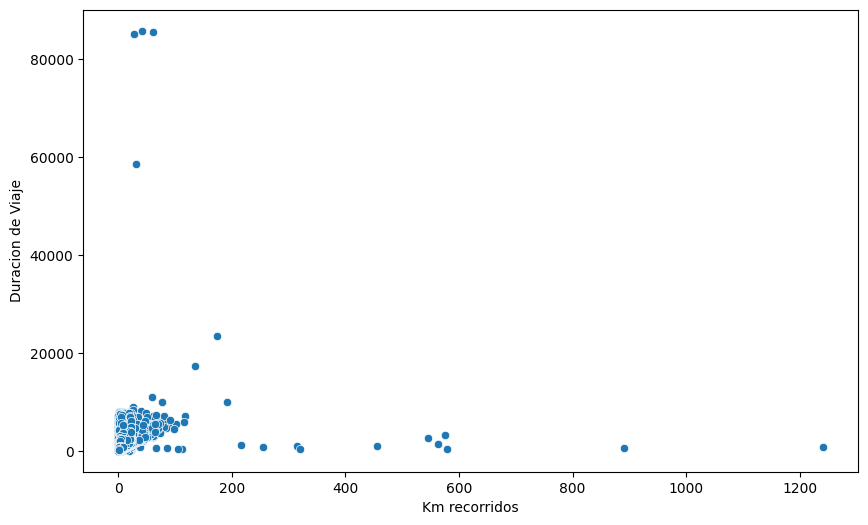

In [ ]:
plt.figure(figsize=(10,6))
sns.scatterplot(x=df["distance_km"],y=df["trip_duration"])
plt.xlabel("Km recorridos")
plt.ylabel("Duracion de Viaje")
plt.show()

In [ ]:
outliers_in_df_2=df[(df["trip_duration"]>30000)&(df["distance_km"]<200)]

In [ ]:
df= df.drop(outliers_in_df_2.index, axis=0)

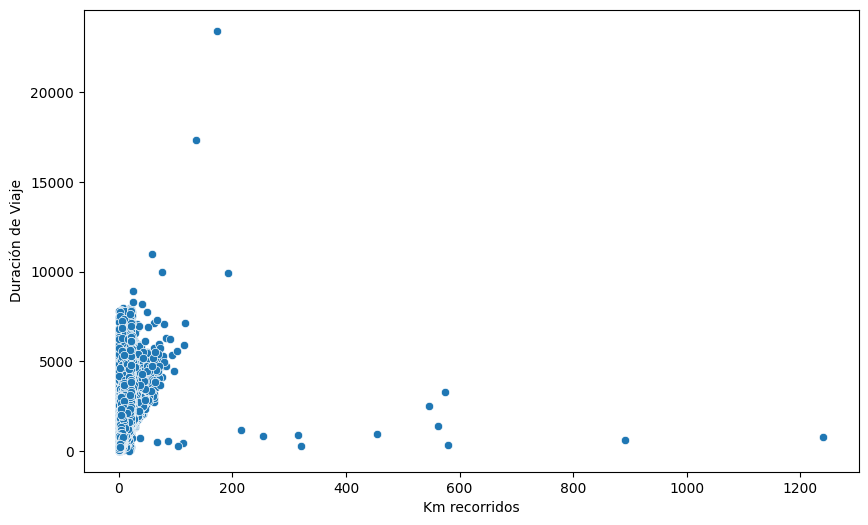

In [ ]:
plt.figure(figsize=(10,6))
sns.scatterplot(x=df["distance_km"],y=df["trip_duration"])
plt.xlabel("Km recorridos")
plt.ylabel("Duración de Viaje")
plt.show()

In [ ]:
outliers_in_df_3=df[(df["trip_duration"]<50000)&(df["distance_km"]>200)]#quitar atipicos

In [ ]:
df= df.drop(outliers_in_df_3.index, axis=0)

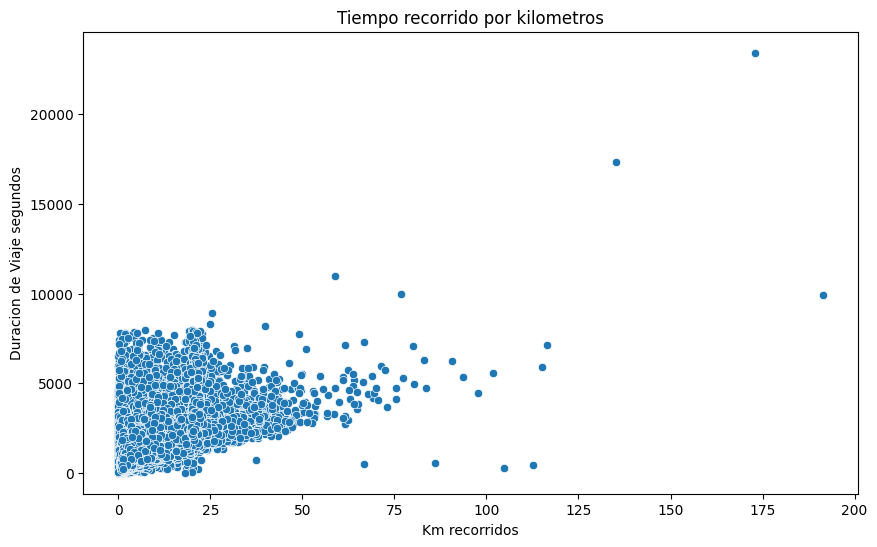

In [ ]:
plt.figure(figsize=(10,6))
sns.scatterplot(x=df["distance_km"],y=df["trip_duration"])
plt.title("Tiempo recorrido por kilometros")
plt.xlabel("Km recorridos")
plt.ylabel("Duracion de Viaje segundos")
plt.show()

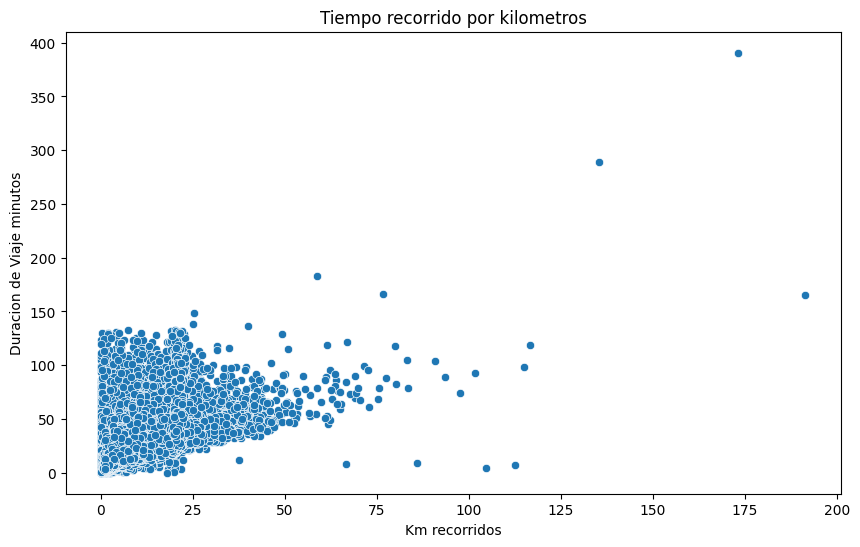

In [ ]:
plt.figure(figsize=(10,6))
sns.scatterplot(x=df["distance_km"],y=df['duracion_viaje_min'])
plt.title("Tiempo recorrido por kilometros")
plt.xlabel("Km recorridos")
plt.ylabel("Duracion de Viaje minutos")
plt.show()

In [ ]:
df[df["distance_km"]<25].describe()#Promedio de tiempo min 13.90 seg 834.28

,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration,dia_recogida,hora_recogida,dia_arrivo,hora_arrivo,duracion_viaje_min,distance_km
count,1455068.000,1455068,1455068,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000,1455068.000
mean,1.534,2016-04-01 10:04:49.341637888,2016-04-01 10:18:43.627731968,1.664,-73.974,40.751,-73.973,40.752,834.286,15.504,13.606,15.504,13.600,13.905,3.408
min,1.000,2016-01-01 00:00:17,2016-01-01 00:03:31,0.000,-121.933,34.360,-121.933,34.360,1.000,1.000,0.000,1.000,0.000,0.017,0.000
25%,1.000,2016-02-17 16:45:39.750000128,2016-02-17 17:00:59.750000128,1.000,-73.992,40.737,-73.991,40.736,396.000,8.000,9.000,8.000,9.000,6.600,1.231
50%,2.000,2016-04-01 17:10:51,2016-04-01 17:27:01,1.000,-73.982,40.754,-73.980,40.755,661.000,15.000,14.000,15.000,14.000,11.017,2.091
75%,2.000,2016-05-15 03:42:10.750000128,2016-05-15 03:51:18.750000128,2.000,-73.967,40.768,-73.963,40.770,1071.000,23.000,19.000,23.000,19.000,17.850,3.865
max,2.000,2016-06-30 23:59:39,2016-07-01 00:48:20,9.000,-61.336,43.912,-61.336,43.912,7979.000,31.000,23.000,31.000,23.000,132.983,25.000
std,0.499,NaN,NaN,1.314,0.070,0.031,0.069,0.034,651.796,8.703,6.399,8.703,6.481,10.863,3.835


In [ ]:
df[df["distance_km"]<50].describe()#Promedio de tiempo min 15.98 seg  959.22

,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration,dia_recogida,hora_recogida,dia_arrivo,hora_arrivo,duracion_viaje_min,distance_km
count,1458556.000,1458556,1458556,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000,1458556.000
mean,1.535,2016-04-01 10:10:39.913017088,2016-04-01 10:26:39.136129792,1.665,-73.973,40.751,-73.973,40.752,959.223,15.504,13.606,15.505,13.599,15.987,3.433
min,1.000,2016-01-01 00:00:17,2016-01-01 00:03:31,0.000,-121.933,34.360,-121.933,34.360,1.000,1.000,0.000,1.000,0.000,0.017,0.000
25%,1.000,2016-02-17 16:46:12.500000,2016-02-17 17:05:35.750000128,1.000,-73.992,40.737,-73.991,40.736,397.000,8.000,9.000,8.000,9.000,6.617,1.232
50%,2.000,2016-04-01 17:19:53,2016-04-01 17:35:13.500000,1.000,-73.982,40.754,-73.980,40.755,662.000,15.000,14.000,15.000,14.000,11.033,2.094
75%,2.000,2016-05-15 03:56:25.500000,2016-05-15 04:11:39,2.000,-73.967,40.768,-73.963,40.770,1075.000,23.000,19.000,23.000,19.000,17.917,3.875
max,2.000,2016-06-30 23:59:39,2016-07-01 23:02:03,9.000,-61.336,43.912,-61.336,43.912,3526282.000,31.000,23.000,31.000,23.000,58771.367,49.749
std,0.499,NaN,NaN,1.314,0.070,0.031,0.069,0.035,5236.990,8.703,6.400,8.703,6.484,87.283,3.922


In [ ]:
df[df["distance_km"]<75].describe()#Promedio de tiempo min 15.99 seg 959.41

,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration,dia_recogida,hora_recogida,dia_arrivo,hora_arrivo,duracion_viaje_min,distance_km
count,1458613.000,1458613,1458613,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000,1458613.000
mean,1.535,2016-04-01 10:10:53.997016320,2016-04-01 10:26:53.409134848,1.665,-73.973,40.751,-73.973,40.752,959.412,15.504,13.606,15.504,13.599,15.990,3.435
min,1.000,2016-01-01 00:00:17,2016-01-01 00:03:31,0.000,-121.933,34.360,-121.933,34.360,1.000,1.000,0.000,1.000,0.000,0.017,0.000
25%,1.000,2016-02-17 16:46:05,2016-02-17 17:05:35,1.000,-73.992,40.737,-73.991,40.736,397.000,8.000,9.000,8.000,9.000,6.617,1.232
50%,2.000,2016-04-01 17:20:00,2016-04-01 17:35:24,1.000,-73.982,40.754,-73.980,40.755,662.000,15.000,14.000,15.000,14.000,11.033,2.094
75%,2.000,2016-05-15 03:57:40,2016-05-15 04:12:22,2.000,-73.967,40.768,-73.963,40.770,1075.000,23.000,19.000,23.000,19.000,17.917,3.875
max,2.000,2016-06-30 23:59:39,2016-07-01 23:02:03,9.000,-61.336,43.912,-61.336,43.912,3526282.000,31.000,23.000,31.000,23.000,58771.367,72.893
std,0.499,NaN,NaN,1.314,0.070,0.031,0.069,0.035,5237.407,8.703,6.400,8.703,6.484,87.290,3.938


(array([8.60526e+05, 4.35081e+05, 1.09897e+05, 3.25480e+04, 1.15400e+04,
        4.40700e+03, 1.61100e+03, 5.55000e+02, 2.01000e+02, 6.60000e+01,
        1.10000e+01, 1.00000e+00, 2.00000e+00, 0.00000e+00, 1.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 1.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 1.00000e+00]),
 array([1.00000e+00, 7.82300e+02, 1.56360e+03, 2.34490e+03, 3.12620e+03,
        3.90750e+03, 4.68880e+03, 5.47010e+03, 6.25140e+03, 7.03270e+03,
        7.81400e+03, 8.59530e+03, 9.37660e+03, 1.01579e+04, 1.09392e+04,
        1.17205e+04, 1.25018e+04, 1.32831e+04, 1.40644e+04, 1.48457e+04,
        1.56270e+04, 1.64083e+04, 1.71896e+04, 1.79709e+04, 1.87522e+04,
        1.95335e+04, 2.03148e+04, 2.10961e+04, 2.18774e+04, 2.26587e+04,
        2.34400e+04]),
 <BarContainer object of 30 artists>)

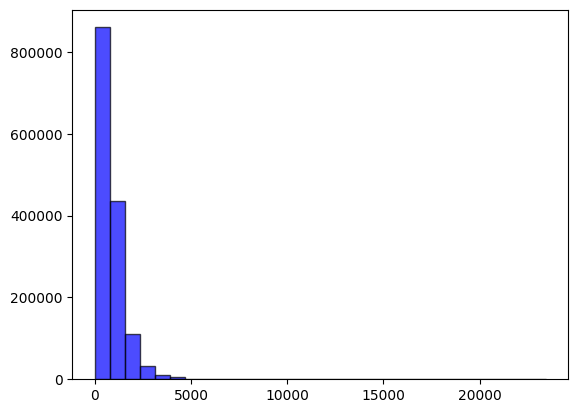

In [ ]:
plt.hist(df['trip_duration'], bins=30, alpha=0.7, color='blue', edgecolor='black')


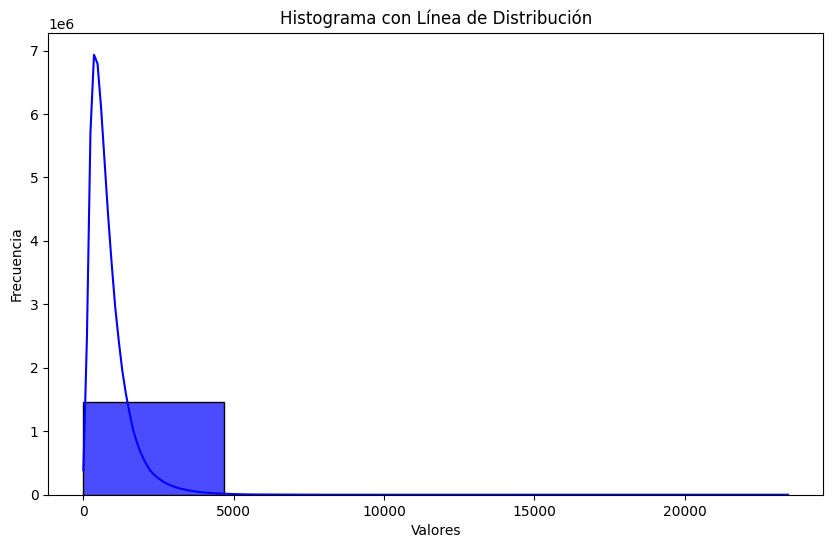

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(df['trip_duration'], color='blue', kde=True, bins=5, alpha=0.7)
plt.title('Histograma con Línea de Distribución')
plt.xlabel('Valores')
plt.ylabel('Frecuencia')
plt.show()


<ipython-input-22-3fd3c78a1768>:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log(df['trip_duration'].values)).set_title("Distribution of Trip Duration")


Text(0.5, 1.0, 'Distribution of trip duration (sec) in Log Scale')

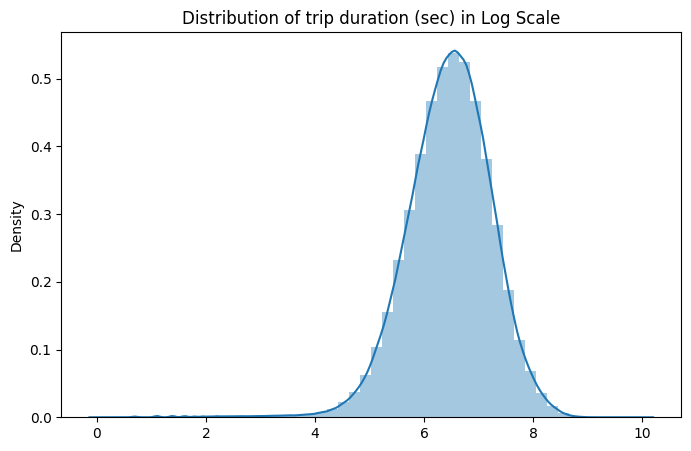

In [ ]:
plt.figure(figsize=(8,5))
sns.distplot(np.log(df['trip_duration'].values)).set_title("Distribution of Trip Duration")
plt.title("Distribution of trip duration (sec) in Log Scale")

In [ ]:
fig = px.histogram(df, x = 'trip_duration', nbins = 30, title = 'Distribución del tiempo en segundos')
fig.update_layout(xaxis_title = 'Tiempo', yaxis_title = 'Frecuencia', template = 'plotly_white', bargap = 0.2)
fig.show()

In [ ]:
fig = px.histogram(df, x = 'duracion_viaje_min', nbins = 30, title = 'Distribución del tiempo en minutos')
fig.update_layout(xaxis_title = 'Tiempo', yaxis_title = 'Frecuencia', template = 'plotly_white', bargap = 0.2)
fig.show()

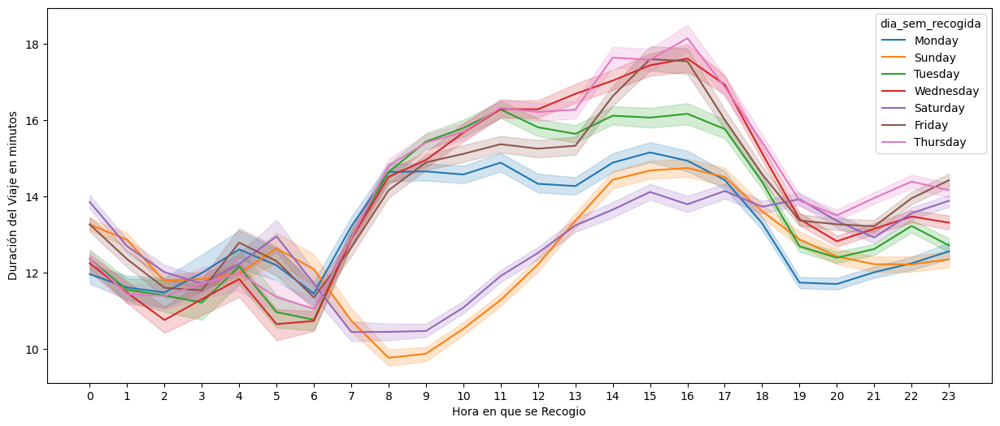

In [ ]:
plt.figure(figsize=(15,6))
sns.lineplot(x="hora_recogida",y="duracion_viaje_min",data= df ,hue="dia_sem_recogida")
plt.xlabel("Hora en que se Recogio")
hourly_ticks = range(0,24) # Adjust as needed
plt.xticks(hourly_ticks)
plt.ylabel("Duración del Viaje en minutos")
plt.show()

In [ ]:
df.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'trip_duration', 'fecha_Recogida', 'dia_recogida', 'hora_recogida',
       'dia_sem_recogida', 'fecha_arrivo', 'dia_arrivo', 'hora_arrivo',
       'dia_sem_arrivo', 'duracion_viaje_min', 'distance_km'],
      dtype='object')

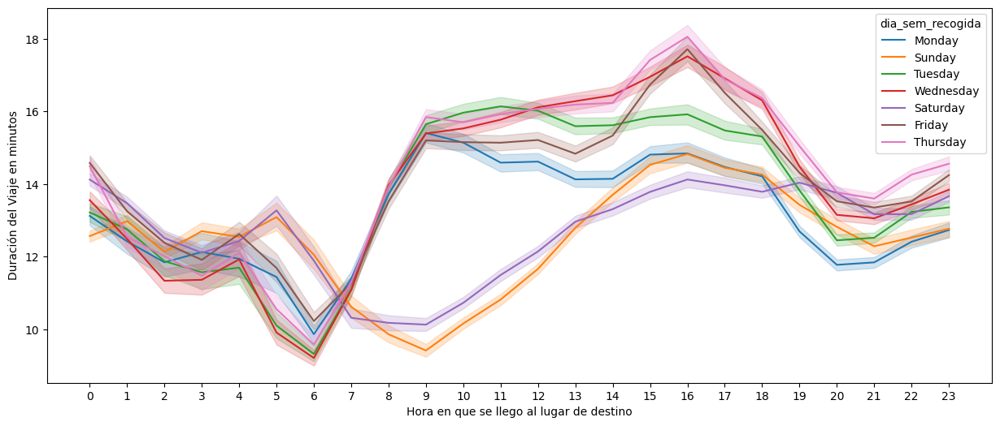

In [ ]:
plt.figure(figsize=(15,6))
sns.lineplot(x="hora_arrivo",y="duracion_viaje_min",data= df ,hue="dia_sem_recogida")
plt.xlabel("Hora en que se llego al lugar de destino")
hourly_ticks = range(0,24) # Adjust as needed
plt.xticks(hourly_ticks)
plt.ylabel("Duración del Viaje en minutos")
plt.show()

In [ ]:
df['passenger_count'] = pd.Categorical(df['passenger_count'])

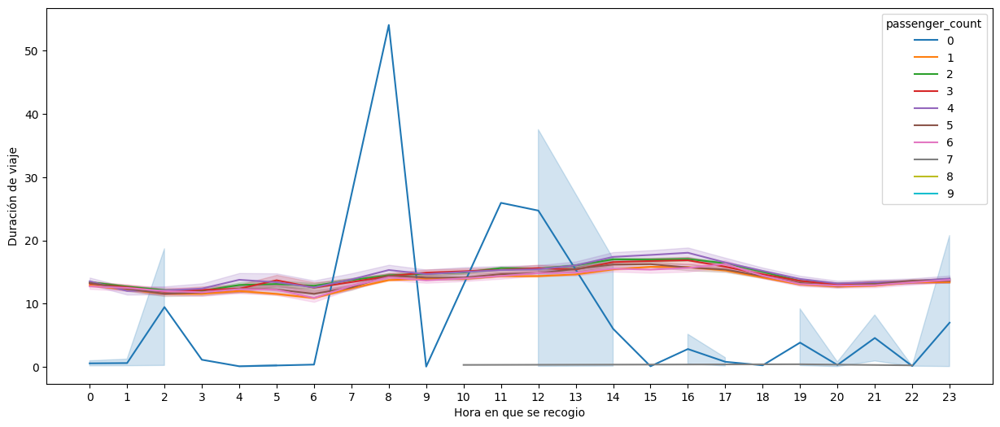

In [ ]:
plt.figure(figsize=(15,6))
sns.lineplot(x="hora_recogida",y="duracion_viaje_min",data=df,hue="passenger_count")
plt.xlabel("Hora en que se recogio")
hourly_ticks = range(0,24) # Adjust as needed
plt.xticks(hourly_ticks)
plt.ylabel("Duración de viaje")
plt.show()

In [ ]:
df1=df.copy()

In [ ]:
outliers_in_df1=df1[df1["passenger_count"]==0]

In [ ]:
df1= df1.drop(outliers_in_df1.index, axis=0)

In [ ]:
df1.shape

(1456390, 21)

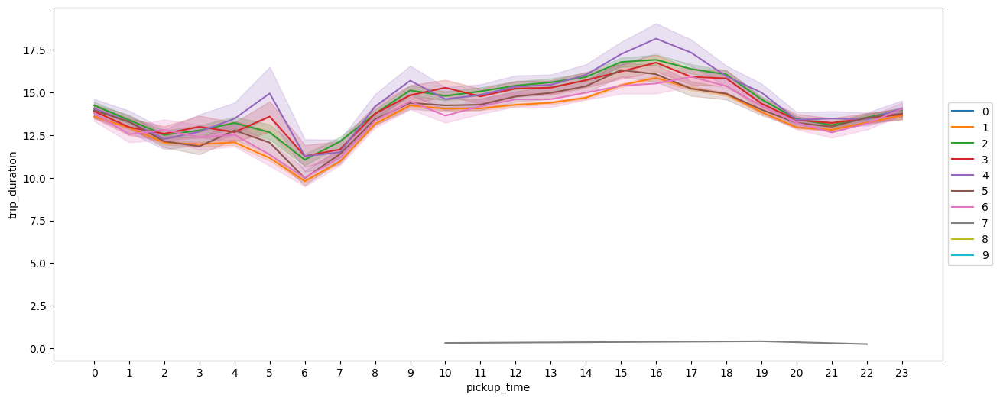

In [ ]:
plt.figure(figsize=(15,6))
sns.lineplot(x="hora_arrivo",y="duracion_viaje_min",hue="passenger_count",data=df1)
plt.xlabel("pickup_time")
hourly_ticks = range(0,24) # Adjust as needed
plt.xticks(hourly_ticks)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel("trip_duration")
plt.show()

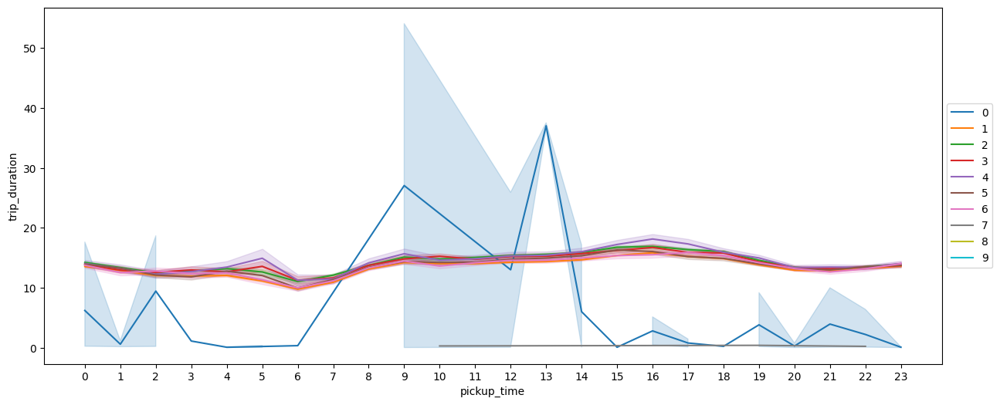

In [ ]:
plt.figure(figsize=(15,6))#columna base original
sns.lineplot(x="hora_arrivo",y="duracion_viaje_min",hue="passenger_count",data=df)
plt.xlabel("pickup_time")
hourly_ticks = range(0,24) # Adjust as needed
plt.xticks(hourly_ticks)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.ylabel("trip_duration")
plt.show()

In [ ]:
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,...,fecha_Recogida,dia_recogida,hora_recogida,dia_sem_recogida,fecha_arrivo,dia_arrivo,hora_arrivo,dia_sem_arrivo,duracion_viaje_min,distance_km
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982,40.768,-73.965,40.766,N,...,2016-03-14,14,17,Monday,2016-03-14,14,17,Monday,7.583,1.499
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980,40.739,-73.999,40.731,N,...,2016-06-12,12,0,Sunday,2016-06-12,12,0,Sunday,11.050,1.806
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979,40.764,-74.005,40.710,N,...,2016-01-19,19,11,Tuesday,2016-01-19,19,12,Tuesday,35.400,6.385
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010,40.720,-74.012,40.707,N,...,2016-04-06,6,19,Wednesday,2016-04-06,6,19,Wednesday,7.150,1.485
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973,40.793,-73.973,40.783,N,...,2016-03-26,26,13,Saturday,2016-03-26,26,13,Saturday,7.250,1.189


In [ ]:
jfk_coords = (40.645730, -73.784467)
ee_coords = (40.773130, -73.873494)#Coordenadas de aeropuestos

In [ ]:
def show_circles_on_map(data, latitude_column, longitude_column, color):
    location = (data[latitude_column].mean(), data[longitude_column].mean())
    m = folium.Map(location=location)

    for _, row in data.iterrows():
        folium.Circle(
            radius=100,
            location=(row[latitude_column], row[longitude_column]),
            color=color,
            fill_color=color,
            fill=True
        ).add_to(m)

    return m

In [ ]:
show_circles_on_map(df.sample(10000), "pickup_latitude", "pickup_longitude", "#006699")

<Axes: xlabel='vendor_id', ylabel='duracion_viaje_min'>

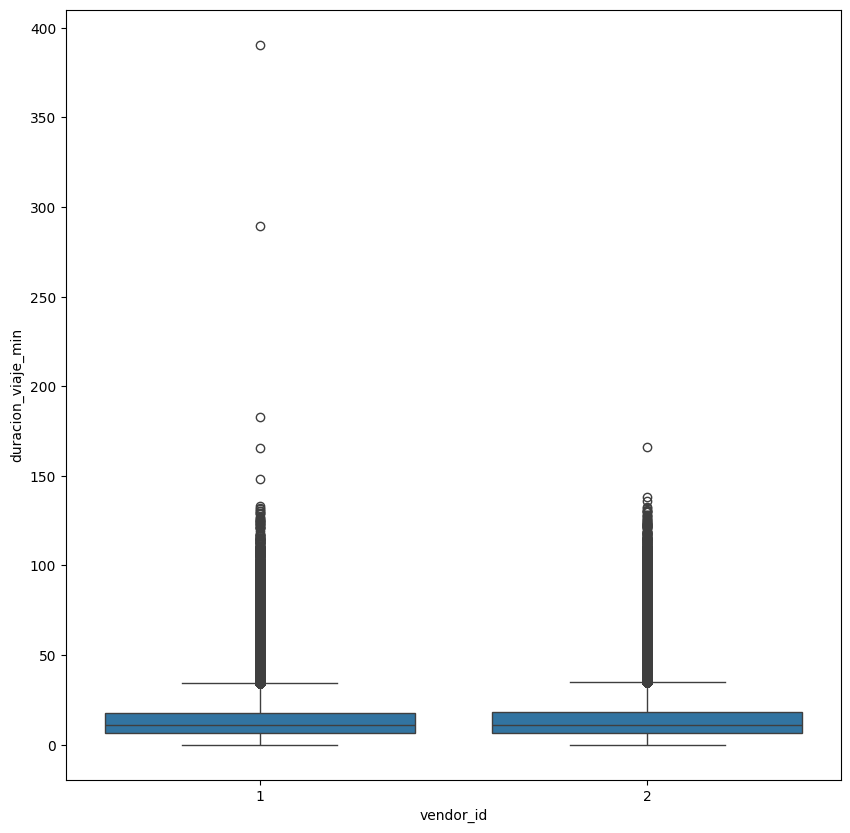

In [ ]:
plt.figure(figsize=(10,10))
sns.boxplot(x='vendor_id', y="duracion_viaje_min", data=df1)

In [ ]:
df.columns

Index(['id', 'vendor_id', 'pickup_datetime', 'dropoff_datetime',
       'passenger_count', 'pickup_longitude', 'pickup_latitude',
       'dropoff_longitude', 'dropoff_latitude', 'store_and_fwd_flag',
       'trip_duration', 'fecha_Recogida', 'dia_recogida', 'hora_recogida',
       'dia_sem_recogida', 'fecha_arrivo', 'dia_arrivo', 'hora_arrivo',
       'dia_sem_arrivo', 'duracion_viaje_min', 'distance_km'],
      dtype='object')

In [ ]:
kilodia = df.groupby('dia_sem_recogida')['distance_km'].sum().reindex(
    ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
)

In [ ]:
kilodia2 = df1.groupby('dia_sem_recogida')['distance_km'].sum().reindex(
    ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
)

In [ ]:
kilodia.head()

dia_sem_recogida
Monday      666937.790
Tuesday     676545.003
Wednesday   699891.416
Thursday    745016.574
Friday      756993.198
Name: distance_km, dtype: float64

Text(0, 0.5, 'Kilómetros Recorridos')

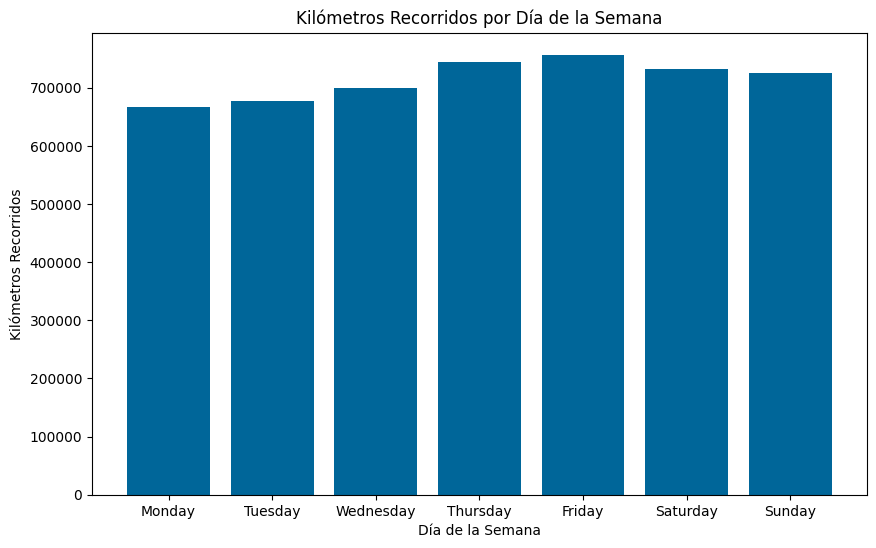

In [ ]:
plt.figure(figsize=(10, 6))#df
plt.bar(kilodia.index, kilodia.values, color='#006699')
plt.title('Kilómetros Recorridos por Día de la Semana')
plt.xlabel('Día de la Semana')
plt.ylabel('Kilómetros Recorridos')

Text(0, 0.5, 'Kilómetros Recorridos')

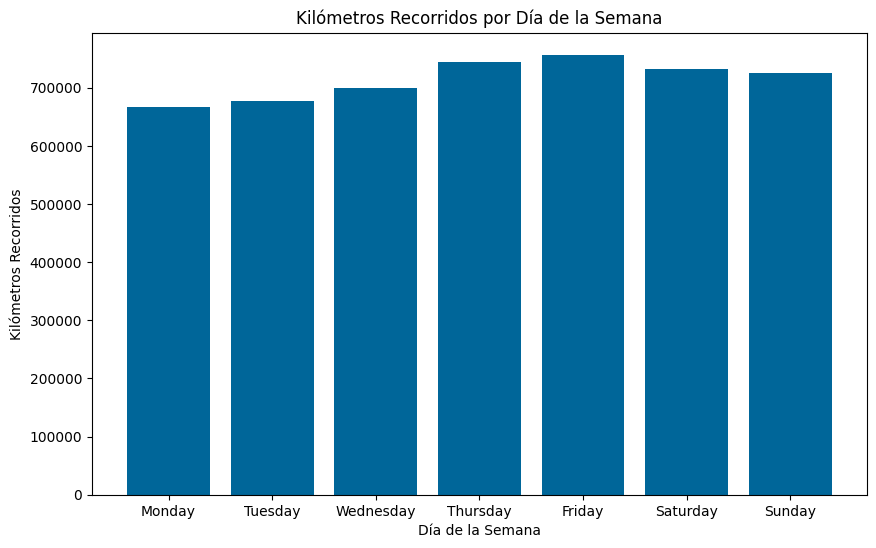

In [ ]:
plt.figure(figsize=(10, 6))#df1
plt.bar(kilodia.index, kilodia.values, color='#006699')
plt.title('Kilómetros Recorridos por Día de la Semana')
plt.xlabel('Día de la Semana')
plt.ylabel('Kilómetros Recorridos')

In [ ]:
dianum = {
    'Monday': 0,
    'Tuesday': 1,
    'Wednesday': 2,
    'Thursday': 3,
    'Friday': 4,
    'Saturday': 5,
    'Sunday': 6
}

In [ ]:
df['dia_ord_sem'] = df['dia_sem_recogida'].map(dianum)

In [ ]:
df1['dia_ord_sem'] = df1['dia_sem_recogida'].map(dianum)

In [ ]:
df.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,...,dia_recogida,hora_recogida,dia_sem_recogida,fecha_arrivo,dia_arrivo,hora_arrivo,dia_sem_arrivo,duracion_viaje_min,distance_km,dia_ord_sem
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982,40.768,-73.965,40.766,N,...,14,17,Monday,2016-03-14,14,17,Monday,7.583,1.499,0
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980,40.739,-73.999,40.731,N,...,12,0,Sunday,2016-06-12,12,0,Sunday,11.050,1.806,6
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979,40.764,-74.005,40.710,N,...,19,11,Tuesday,2016-01-19,19,12,Tuesday,35.400,6.385,1
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010,40.720,-74.012,40.707,N,...,6,19,Wednesday,2016-04-06,6,19,Wednesday,7.150,1.485,2
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973,40.793,-73.973,40.783,N,...,26,13,Saturday,2016-03-26,26,13,Saturday,7.250,1.189,5


In [ ]:
df3 = df.select_dtypes(include=['number'])#df

In [ ]:
df3_1 = df1.select_dtypes(include=['number'])#df1

In [ ]:
df3.head()

,vendor_id,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration,dia_recogida,hora_recogida,dia_arrivo,hora_arrivo,duracion_viaje_min,distance_km,dia_ord_sem
0,2,-73.982,40.768,-73.965,40.766,455,14,17,14,17,7.583,1.499,0
1,1,-73.980,40.739,-73.999,40.731,663,12,0,12,0,11.050,1.806,6
2,2,-73.979,40.764,-74.005,40.710,2124,19,11,19,12,35.400,6.385,1
3,2,-74.010,40.720,-74.012,40.707,429,6,19,6,19,7.150,1.485,2
4,2,-73.973,40.793,-73.973,40.783,435,26,13,26,13,7.250,1.189,5


In [ ]:
corr_matrix = df3.corr()
fig = px.imshow(corr_matrix, x = corr_matrix.columns, y = corr_matrix.columns, color_continuous_scale = 'RdBu',  range_color=[-1,1], text_auto = True, aspect = "auto")
fig.update_layout(title='Correlation Heatmap')
fig.update(layout_coloraxis_showscale=False)
fig.show()

In [ ]:
df4=df3.drop(columns=['vendor_id','trip_duration','dia_recogida','dia_arrivo'],axis=1)#df

In [ ]:
df4_1=df3_1.drop(columns=['vendor_id','trip_duration','dia_recogida','dia_arrivo'],axis=1)#df1

In [ ]:
df4.head()

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,hora_recogida,hora_arrivo,duracion_viaje_min,distance_km,dia_ord_sem
0,-73.982,40.768,-73.965,40.766,17,17,7.583,1.499,0
1,-73.980,40.739,-73.999,40.731,0,0,11.050,1.806,6
2,-73.979,40.764,-74.005,40.710,11,12,35.400,6.385,1
3,-74.010,40.720,-74.012,40.707,19,19,7.150,1.485,2
4,-73.973,40.793,-73.973,40.783,13,13,7.250,1.189,5


In [ ]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1456449 entries, 0 to 1458643
Data columns (total 9 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   pickup_longitude    1456449 non-null  float64
 1   pickup_latitude     1456449 non-null  float64
 2   dropoff_longitude   1456449 non-null  float64
 3   dropoff_latitude    1456449 non-null  float64
 4   hora_recogida       1456449 non-null  int64  
 5   hora_arrivo         1456449 non-null  int64  
 6   duracion_viaje_min  1456449 non-null  float64
 7   distance_km         1456449 non-null  float64
 8   dia_ord_sem         1456449 non-null  int64  
dtypes: float64(6), int64(3)
memory usage: 143.4 MB


In [ ]:
df4['duracion_viaje_min'].mean()

13.940245304389874

In [ ]:
tiempo=df4.pop('duracion_viaje_min')#df

KeyError: 'duracion_viaje_min'

In [ ]:
tiempo1=df4_1.pop('duracion_viaje_min')#df1

In [ ]:
#volvemos agregar la columna, al final
df4['Tiempo_min']=tiempo

In [ ]:
df4_1['Tiempo_min']=tiempo

In [ ]:
df4.head()

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,hora_recogida,hora_arrivo,distance_km,dia_ord_sem,Tiempo_min
0,-73.982,40.768,-73.965,40.766,17,17,1.499,0,7.583
1,-73.980,40.739,-73.999,40.731,0,0,1.806,6,11.050
2,-73.979,40.764,-74.005,40.710,11,12,6.385,1,35.400
3,-74.010,40.720,-74.012,40.707,19,19,1.485,2,7.150
4,-73.973,40.793,-73.973,40.783,13,13,1.189,5,7.250


In [ ]:
df4_1.head()

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,hora_recogida,hora_arrivo,distance_km,dia_ord_sem,Tiempo_min
0,-73.982,40.768,-73.965,40.766,17,17,1.499,0,7.583
1,-73.980,40.739,-73.999,40.731,0,0,1.806,6,11.050
2,-73.979,40.764,-74.005,40.710,11,12,6.385,1,35.400
3,-74.010,40.720,-74.012,40.707,19,19,1.485,2,7.150
4,-73.973,40.793,-73.973,40.783,13,13,1.189,5,7.250


In [ ]:
tiempo.mean()

13.940245304389874

In [ ]:
fig = px.scatter_matrix(df4, dimensions=df4.columns[:-1], title='Pairwise Scatter Plot', height = 1000, color = 'Tiempo_min')
fig.update_traces(diagonal_visible=False)
fig.show()


regresion multivariable

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score


In [ ]:
X = df4_1.drop('Tiempo_min', axis=1)
y = df4_1['Tiempo_min']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)


In [ ]:
model = LinearRegression()
model.fit(X_train, y_train)


LinearRegression()

In [ ]:
y_pred = model.predict(X_test)


In [ ]:
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f'Mean Squared Error: {mse}')
print(f'R-squared: {r2}')

Mean Squared Error: 48.010452867422984
R-squared: 0.5971900171263285


MODELO REGRESION

In [ ]:
X = df4_1.drop('Tiempo_min', axis=1)
y = df4_1['Tiempo_min']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 42)


In [ ]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
svm = SVR()
svm.fit(X_train_scaled, y_train)

In [ ]:
y_pred_svm = svm.predict(X_test_scaled)
mse_svm = mean_squared_error(y_test, y_pred_svm)
print(f"SVM MSE: {mse_svm:.2f}")

SVM MSE: 0.46


In [ ]:
svm_r2 = r2_score(y_test, y_pred_svm)
print(f"SVM R^2 Score: {svm_r2:.2f}")

SVM R^2 Score: 0.53


In [ ]:
param_grid_svm = {
    'C': [0.1, 1, 10],
    'kernel': ['linear', 'poly', 'rbf']
}


In [ ]:
svm = SVR()
grid_search_svm = GridSearchCV(estimator = svm, param_grid=param_grid_svm, cv=5)
grid_search_svm.fit(X_train_scaled, y_train)


GridSearchCV(cv=5, estimator=SVR(),
             param_grid={'C': [0.1, 1, 10],
                         'kernel': ['linear', 'poly', 'rbf']})

In [ ]:
best_params_svm = grid_search_svm.best_params_
best_params_svm


{'C': 1, 'kernel': 'rbf'}

In [ ]:
best_model_svm = grid_search_svm.best_estimator_
best_model_svm

SVR(C=1)

In [ ]:
y_pred_best_svm = best_model_svm.predict(X_test_scaled)
mse_best_svm = mean_squared_error(y_test, y_pred_best_svm)
print(f"SVM MSE: {mse_best_svm:.2f}")

SVM MSE: 0.46


ARBOL DE DESICION


id                      0
title                   0
type                    0
description             0
release_year            0
age_certification       0
runtime                 0
genres                  0
production_countries    0
seasons                 0
imdb_id                 0
imdb_score              0
imdb_votes              0
tmdb_popularity         0
tmdb_score              0
imdbvotes               0
dtype: int64

In [ ]:
df_2.head()

,runtime,imdb_score,imdb_votes,tmdb_popularity,imdbvotes,tmdb_scores
id,,,,,,
tm155702,102,8.1,389774.0,41.442,389774.0,7.6
tm83648,119,8.3,433804.0,14.383,433804.0,8.0
tm77588,102,8.5,558849.0,20.087,558849.0,8.2
tm156463,233,8.2,309856.0,24.092,309856.0,8.0
tm47834,117,8.3,155068.0,9.165,155068.0,8.1


In [ ]:
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train_scaled, y_train)


DecisionTreeRegressor(random_state=42)

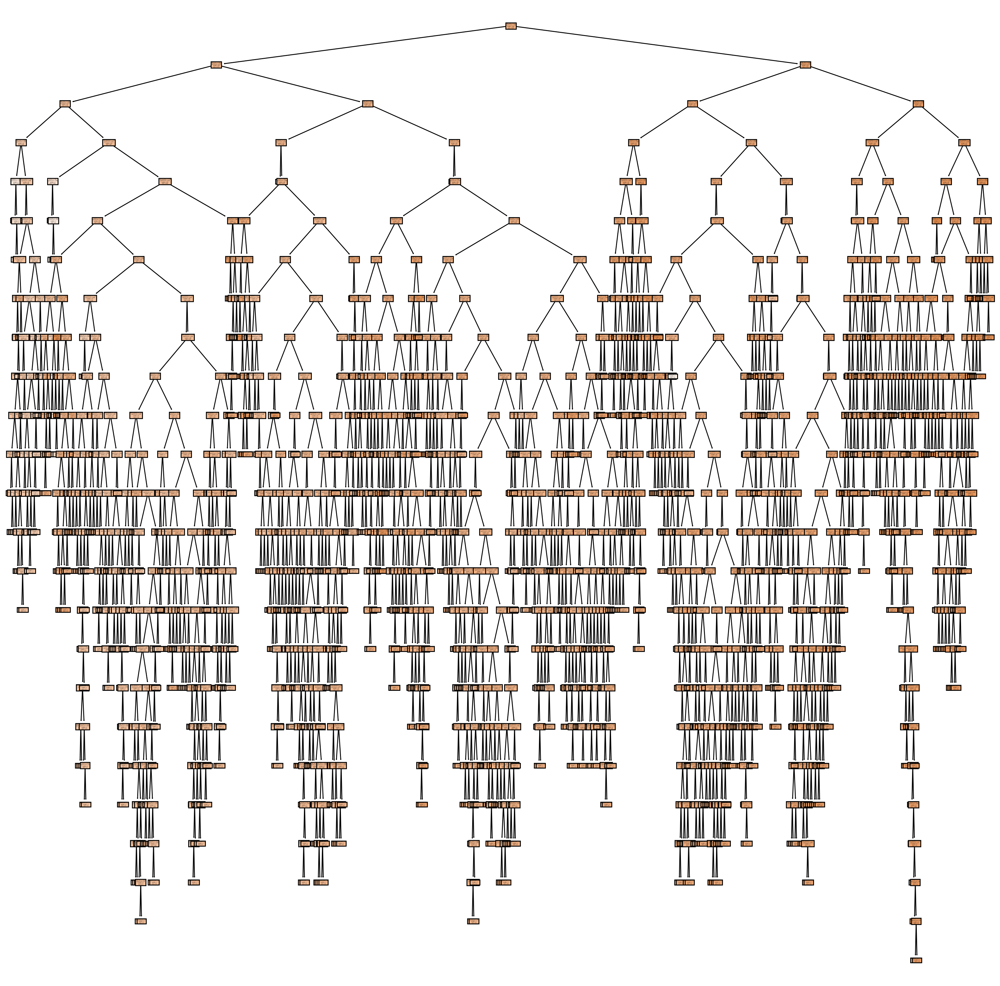

In [ ]:
plt.figure(figsize=(20, 20), dpi=200)
plot_tree(dt, feature_names = df_2.columns[:-1], filled=True)
plt.show()

In [ ]:
y_pred_dt = dt.predict(X_test_scaled)
mse_dt = mean_squared_error(y_test, y_pred_dt)
print(f"Decision Trees MSE: {mse_dt:.2f}")


Decision Trees MSE: 0.89


In [ ]:
dt_r2 = r2_score(y_test, y_pred_dt)
print(f"DT R^2 Score: {dt_r2:.2f}")

DT R^2 Score: 0.10


In [ ]:
param_grid_dt = {
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10],
    'criterion': ['friedman_mse', 'absolute_error', 'squared_error']}


In [ ]:
dt = DecisionTreeRegressor(random_state=42)
grid_search_dt = GridSearchCV(estimator=dt, param_grid=param_grid_dt, cv=5)
grid_search_dt.fit(X_train_scaled, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeRegressor(random_state=42),
             param_grid={'criterion': ['friedman_mse', 'absolute_error',
                                       'squared_error'],
                         'max_depth': [None, 5, 10],
                         'min_samples_split': [2, 5, 10]})

In [ ]:
best_params_dt = grid_search_dt.best_params_
best_params_dt

{'criterion': 'absolute_error', 'max_depth': 5, 'min_samples_split': 2}

In [ ]:
best_model_dt = grid_search_dt.best_estimator_
best_model_dt

DecisionTreeRegressor(criterion='absolute_error', max_depth=5, random_state=42)

In [ ]:
y_pred_best_dt = best_model_dt.predict(X_test_scaled)
mse_best_dt = mean_squared_error(y_test, y_pred_best_dt)
print(f"DT MSE: {mse_best_dt:.2f}")

DT MSE: 0.53


Random Forest

In [ ]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train_scaled, y_train)

RandomForestRegressor(random_state=42)

In [ ]:
y_pred_rf = rf.predict(X_test_scaled)
mse_rf = mean_squared_error(y_test, y_pred_rf)
print(f"Random Forest MSE: {mse_rf:.2f}")

Random Forest MSE: 0.50


In [ ]:
rf_r2 = r2_score(y_test, y_pred_dt)
print(f"RF R^2 Score: {rf_r2:.2f}")

RF R^2 Score: 0.10


In [ ]:
param_grid_rf = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10],
    'min_samples_split': [2, 5, 10],
    'criterion': ['friedman_mse', 'absolute_error', 'squared_error']}

In [ ]:
rf = RandomForestRegressor(random_state=42)
grid_search_rf = GridSearchCV(estimator=rf, param_grid=param_grid_rf, cv=5)
grid_search_rf.fit(X_train_scaled, y_train)


GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
             param_grid={'criterion': ['friedman_mse', 'absolute_error',
                                       'squared_error'],
                         'max_depth': [None, 5, 10],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]})

In [ ]:
best_params_rf = grid_search_rf.best_params_
best_params_rf

{'criterion': 'squared_error',
 'max_depth': None,
 'min_samples_split': 10,
 'n_estimators': 300}

In [ ]:
best_model_rf = grid_search_rf.best_estimator_
best_model_rf

In [ ]:
y_pred_best_rf = best_model_rf.predict(X_test_scaled)
mse_best_rf = mean_squared_error(y_test, y_pred_best_rf)
print(f"RF MSE: {mse_best_rf:.2f}")

In [ ]:
X = df_1.drop('tmdb_scores', axis=1)

In [ ]:
wcss = []

for k in range(1, 11):
    kmeans = KMeans(n_clusters = k, random_state = 42, n_init = 10)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)

wcss

[167352827310801.44,
 65345593169116.94,
 29964349178524.594,
 17204563003554.035,
 10631299431368.219,
 7523788002674.08,
 5509542262815.095,
 3976679294254.2627,
 2864889691770.823,
 2393441708943.613]

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=list(range(1, 11)), y=wcss, mode='lines+markers', name='WCSS'))
fig.update_layout(title='Elbow Method for Optimal K',
                  xaxis_title='Number of Clusters (K)',
                  yaxis_title='WCSS',
                  xaxis=dict(tickmode='linear', tickvals=list(range(1, 11))),
                  yaxis=dict(rangemode='tozero'),
                  template = 'plotly_white')
fig.show()

In [ ]:
silhouette_scores = []

for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init = 10)
    cluster_labels = kmeans.fit_predict(X)
    silhouette_scores.append(silhouette_score(X, cluster_labels))
silhouette_scores

[0.856428522015481,
 0.8092639247618518,
 0.7676435935963104,
 0.7383775124979474,
 0.7014767988612003,
 0.7098424852962122,
 0.673063858247455,
 0.6713783836507966,
 0.6577210748173323]

In [ ]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = list(range(2, 11)), y = silhouette_scores, mode = 'lines+markers', name = 'Silhouette Score'))
fig.update_layout(title = 'Silhouette Score for Optimal K',
                  xaxis_title = 'Number of Clusters (K)',
                  yaxis_title = 'Silhouette Score',
                  xaxis = dict(tickmode='linear', tickvals=list(range(2, 11))),
                  yaxis = dict(rangemode='tozero'),
                  template = 'plotly_white')
fig.show()

In [ ]:
kmeans = KMeans(n_clusters=3, random_state=42, n_init = 10)
kmeans.fit(X)

KMeans(n_clusters=3, n_init=10, random_state=42)

In [ ]:
df_1_c3 = df_1.copy()
df_1_c3['cluster'] = kmeans .labels_
df_1_c3['cluster'] = df_1_c3.cluster.astype(str)
fig = px.scatter(df_1_c3, x = 'imdb_score', y = 'tmdb_popularity', color = 'cluster', template = 'plotly_white', title = 'Cluster - 3')
fig.show()